# **CLASS_1**

## general framework

**QUESTIONS:**<br>
    HOW CAN WE ADVANCE OUR UNDERSTANDING OF THE BUILT ENVIRONMENT USING DEEP LEARNING?<br>
    WHAT CAN WE LEARN FROM REMOTE SENSING-DATA?<br>
    HOW CAN WE GAIN HIGH RESOLUTION INSIGHTS USING LOW RESOLUTION DATA?<br>

**what is environmental data?**
1. any information collected about the built and natural environment
2. we collect this data using climate stations: 42% percent of the data they produce is image based

**scales of anaylis**
1. micro: urban / architectural
2. meso: regional / naational
3. macro: global

**challenges**
1. highly complex
2. computational intensive
3. low availability

**why work with environmental data**
1. bcs we can actually measure the impact and limits of our actions.

**how can we use environmental data?**

## ai for the built envirionment:

1. ai for design
2. ai for mapping
3. ai for analysis

**Deep learning**

early level: pixel processing<br>
middle level: feature processing<br>
high level: Object meaning<br>

projects:

predictive information modeling

QUESTIONS<BR>

CAN WE COMBINE MODELS SO THEY WORK IN TANDEM TO COMPLETE A TASK IN THE MOST EFFICIENT WAY POSSIBLE?

# **CLASS_2**

**where do we find satellite imagery**

databases:
1. european space agency sentinel-1
2. copernicus open hub sentinel-2

APIs:
1. google earth engine
2. open street maps
3. mapbox

**methods of image classification**

training:
create your won dataset and select the correct architecture for training a model.

inferencing:
you use a pretrained dataset and adjust the weights of it.

**some tips and tricks for geo data:**

how to get the data:
1. rquesting from api using requests!

# **CLASS_3**

# **ASSIGMENT**

Image dimensions: 2232px × 2232px
Resolution: 0.90 meters per pixel
Downloaded 10/90 tiles (11.1%)
Downloaded 20/90 tiles (22.2%)
Downloaded 30/90 tiles (33.3%)
Downloaded 40/90 tiles (44.4%)
Downloaded 50/90 tiles (55.6%)
Downloaded 60/90 tiles (66.7%)
Downloaded 70/90 tiles (77.8%)
Downloaded 80/90 tiles (88.9%)
Downloaded 90/90 tiles (100.0%)
Large image saved to barcelona_large_2km.png
Actual area covered: 1999.7m × 1999.7m
Grid overlay image saved to barcelona_large_2km_grid_preview.png


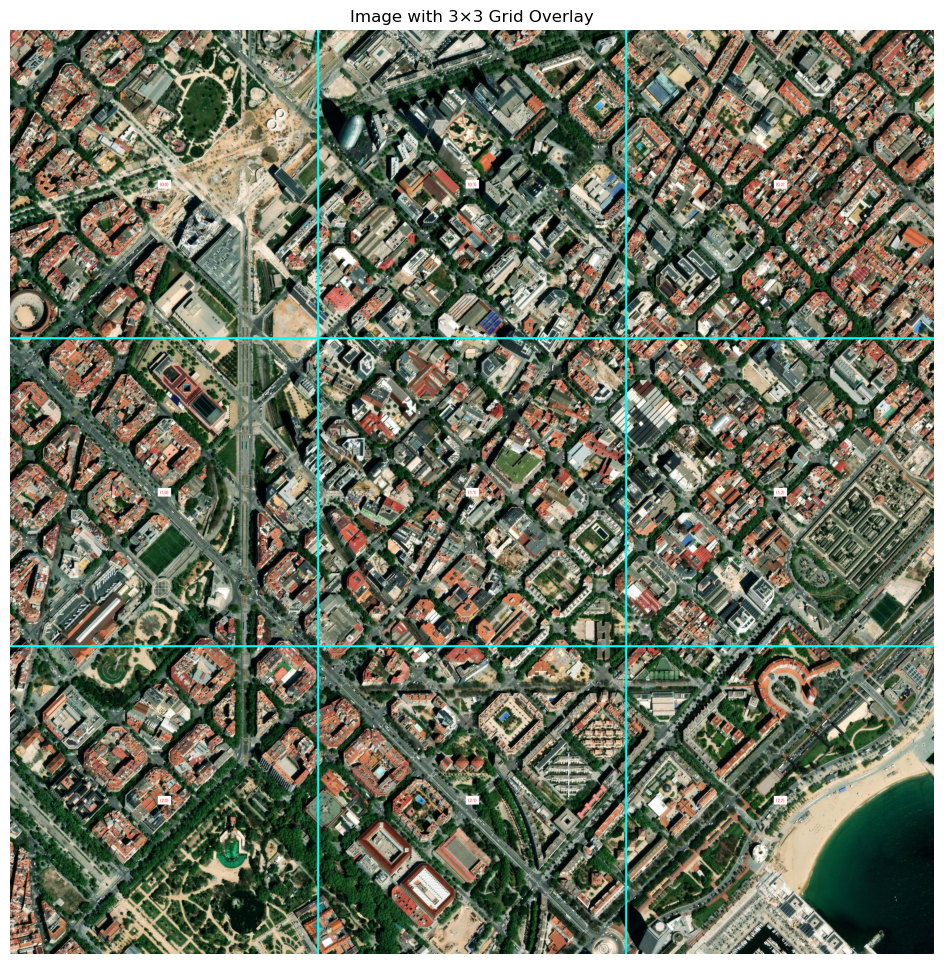

Saved tile to efficient_tiles/tile_41.396536_2.194554_r0_c0.png


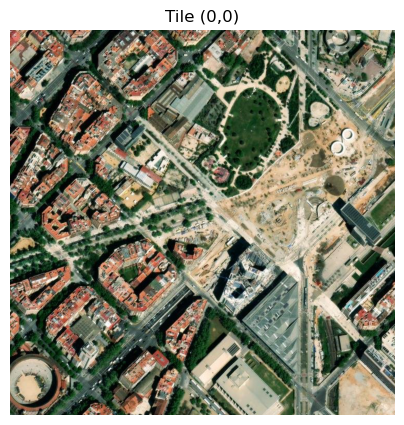

Saved tile to efficient_tiles/tile_41.396536_2.194554_r0_c1.png


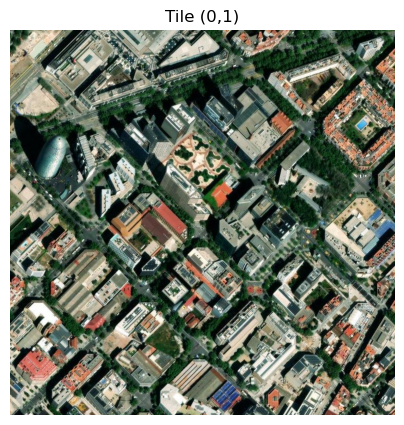

Saved tile to efficient_tiles/tile_41.396536_2.194554_r0_c2.png


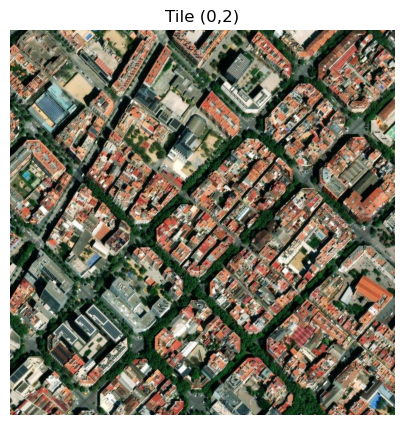

Saved tile to efficient_tiles/tile_41.396536_2.194554_r1_c0.png


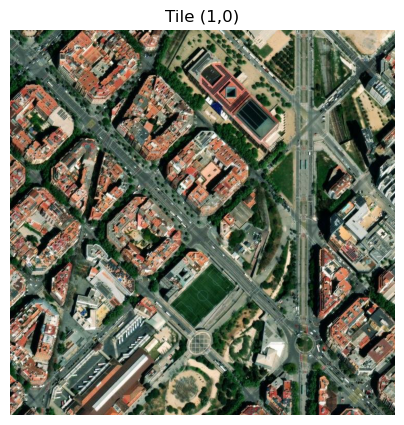

Saved tile to efficient_tiles/tile_41.396536_2.194554_r1_c1.png


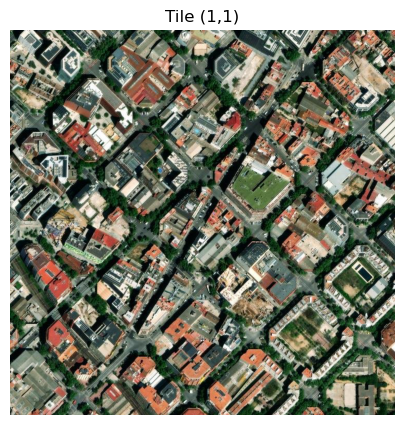

Saved tile to efficient_tiles/tile_41.396536_2.194554_r1_c2.png


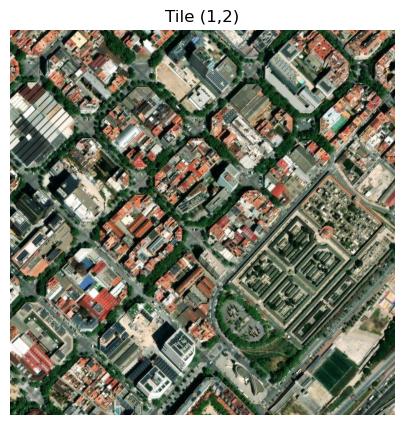

Saved tile to efficient_tiles/tile_41.396536_2.194554_r2_c0.png


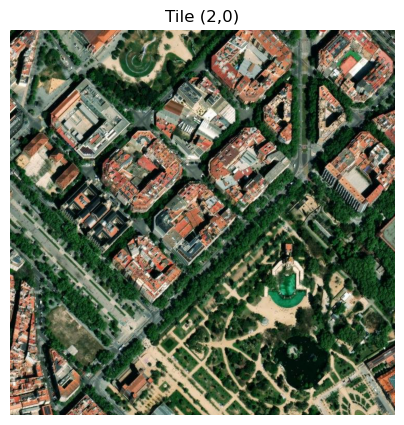

Saved tile to efficient_tiles/tile_41.396536_2.194554_r2_c1.png


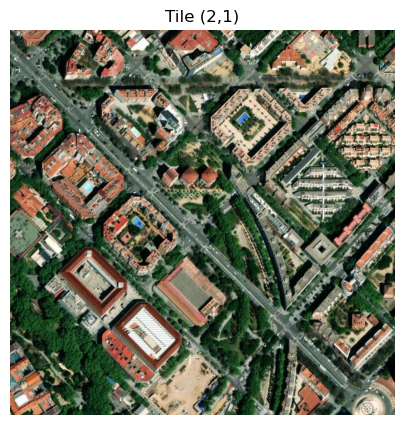

Saved tile to efficient_tiles/tile_41.396536_2.194554_r2_c2.png


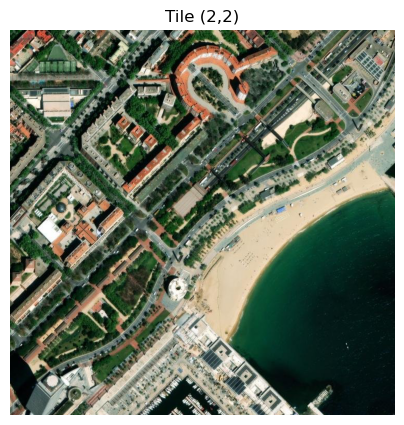

Mosaic saved to mosaic_41.396536_2.194554.png


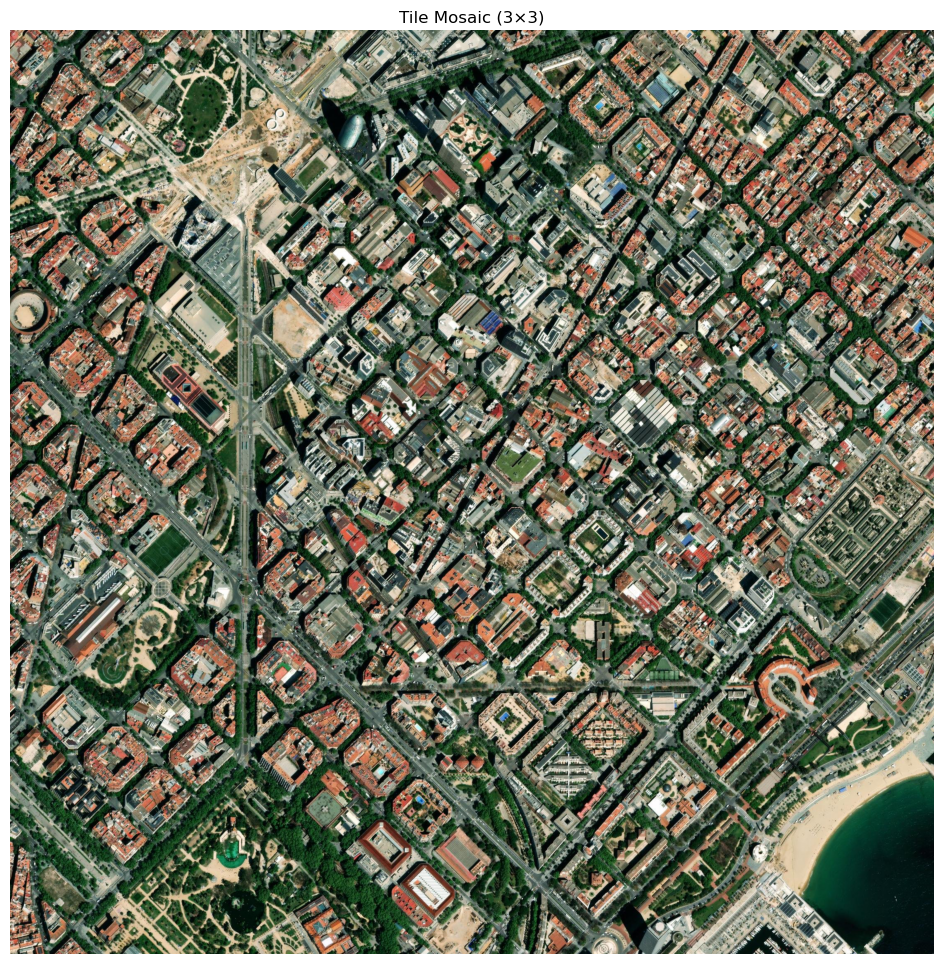

Each tile covers approximately 666.6m × 666.6m


In [1]:
"""
Efficient Satellite Image Tile Generator
---------------------------------------
This script downloads one large satellite image and cuts it into tiles.
Much more efficient than downloading individual tiles separately.
"""

import io
import requests
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image, ImageDraw, ImageFont
import math
import os

def calculate_zoom_for_physical_size(lat, physical_size_meters, width_pixels=800):
    """
    Calculate appropriate zoom level for a specific physical area.

    This function determines which zoom level will display the area at
    the desired physical size with appropriate resolution.
    """
    # Earth's circumference at the equator in meters
    earth_circumference = 40075016.686

    # At zoom level 0, the entire world is 256 pixels wide
    meters_per_pixel_at_zoom_0 = earth_circumference / 256

    # Adjust for latitude (distances get smaller as you move away from equator)
    meters_per_pixel_at_lat_zoom_0 = meters_per_pixel_at_zoom_0 * np.cos(np.radians(lat))

    # Calculate how many meters each pixel needs to represent
    meters_per_pixel_needed = physical_size_meters / width_pixels

    # Calculate the zoom level where pixels will represent this physical size
    # Each zoom level doubles the detail (halves the physical size per pixel)
    zoom = np.log2(meters_per_pixel_at_lat_zoom_0 / meters_per_pixel_needed)

    # Round and clamp to valid zoom range (1-19)
    return max(1, min(19, round(zoom)))

def download_large_satellite_image(lat, lon, width_meters, height_meters, resolution, output_file=None):
    """
    Download a large satellite image covering the specified area.

    This is the main function that determines the appropriate zoom level
    and dimensions for the image, then downloads it.
    """
    # Calculate zoom level based on the larger dimension
    # This ensures we get the right level of detail
    larger_dimension_meters = max(width_meters, height_meters)
    zoom = calculate_zoom_for_physical_size(lat, larger_dimension_meters, resolution)

    # Calculate actual meters per pixel at this zoom level
    # This tells us the ground resolution of our image
    earth_circumference = 40075016.686
    meters_per_pixel = (earth_circumference * np.cos(np.radians(lat))) / (256 * (2 ** zoom))

    # Calculate required image dimensions in pixels
    # This converts our desired physical dimensions to pixel dimensions
    width_pixels = int(width_meters / meters_per_pixel)
    height_pixels = int(height_meters / meters_per_pixel)

    print(f"Downloading {width_meters}m × {height_meters}m area at zoom level {zoom}")
    print(f"Image dimensions: {width_pixels}px × {height_pixels}px")
    print(f"Resolution: {meters_per_pixel:.2f} meters per pixel")

    # Use the download function to get the actual image
    image = download_esri_satellite_image(lat, lon, width_pixels, height_pixels, zoom, output_file)

    # Return the image and actual dimensions
    # The actual dimensions might differ slightly from requested due to rounding
    actual_width_meters = width_pixels * meters_per_pixel
    actual_height_meters = height_pixels * meters_per_pixel

    return image, actual_width_meters, actual_height_meters

def download_esri_satellite_image(lat, lon, width, height, zoom, output_file=None):
    """
    Download a satellite image from ESRI World Imagery service.

    This function handles the actual downloading of tiles from the
    ESRI map service and stitches them together.
    """
    # These helper functions convert geographic coordinates to tile coordinates
    # This is how we determine which map tiles to download
    def lon_to_x(lon, zoom):
        return ((lon + 180) / 360) * (2 ** zoom)

    def lat_to_y(lat, zoom):
        lat_rad = math.radians(lat)
        return (1 - math.log(math.tan(lat_rad) + 1/math.cos(lat_rad)) / math.pi) / 2 * (2 ** zoom)

    # Calculate the center tile coordinates
    x_tile = lon_to_x(lon, zoom)
    y_tile = lat_to_y(lat, zoom)

    # Create a blank image to hold our map
    result = Image.new('RGB', (width, height))

    # Calculate the range of tiles we need to download
    # Map tiles are 256×256 pixels, so we calculate how many we need
    x_min = int(x_tile - (width / 256) / 2)
    y_min = int(y_tile - (height / 256) / 2)
    x_max = int(x_tile + (width / 256) / 2) + 1
    y_max = int(y_tile + (height / 256) / 2) + 1

    # Track download progress
    total_tiles = (x_max - x_min) * (y_max - y_min)
    tiles_downloaded = 0

    print(f"Downloading {total_tiles} map tiles...")

    # Download each tile and stitch them together
    # This loops through all the tiles we need and downloads each one
    for x in range(x_min, x_max):
        for y in range(y_min, y_max):
            # ESRI World Imagery tile URL format
            url = f"https://server.arcgisonline.com/ArcGIS/rest/services/World_Imagery/MapServer/tile/{zoom}/{y}/{x}"

            try:
                # Download the tile
                response = requests.get(url)
                if response.status_code == 200:
                    # Convert the response to an image
                    tile = Image.open(io.BytesIO(response.content))

                    # Calculate where to paste this tile in our result image
                    paste_x = (x - x_min) * 256
                    paste_y = (y - y_min) * 256

                    # Paste the tile into the result image
                    result.paste(tile, (paste_x, paste_y))

                    # Update progress
                    tiles_downloaded += 1
                    if tiles_downloaded % 10 == 0 or tiles_downloaded == total_tiles:
                        print(f"Downloaded {tiles_downloaded}/{total_tiles} tiles ({tiles_downloaded/total_tiles*100:.1f}%)")

            except Exception as e:
                print(f"Error downloading tile {x},{y}: {e}")

    # Crop image to exact dimensions
    # This ensures we get exactly the size we requested
    center_x = (width // 2)
    center_y = (height // 2)
    left = center_x - (width // 2)
    upper = center_y - (height // 2)
    right = center_x + (width // 2)
    lower = center_y + (height // 2)

    result = result.crop((left, upper, right, lower))

    # Save if output file specified
    if output_file:
        result.save(output_file)
        print(f"Large image saved to {output_file}")

    return result

def add_grid_overlay(image, rows, cols, output_file=None):
    """
    Add a grid overlay to an image with row and column labels.

    This function adds a visual grid showing how the image will be divided,
    with coordinates for each tile.
    """
    # Create a copy of the image to draw on
    overlay_image = image.copy().convert('RGBA')
    draw = ImageDraw.Draw(overlay_image)

    # Get image dimensions
    width, height = image.size

    # Calculate tile dimensions
    tile_width = width // cols
    tile_height = height // rows

    # Draw vertical grid lines
    for i in range(1, cols):
        x = i * tile_width
        draw.line([(x, 0), (x, height)], fill=(0, 255, 255, 180), width=5)

    # Draw horizontal grid lines
    for i in range(1, rows):
        y = i * tile_height
        draw.line([(0, y), (width, y)], fill=(0, 255, 255, 180), width=5)

    # Draw tile labels
    try:
        # Try to use a TrueType font if available
        font = ImageFont.truetype("arial.ttf", 40)
    except IOError:
        # Fallback to default font
        font = ImageFont.load_default()

    for row in range(rows):
        for col in range(cols):
            # Calculate center of the tile
            center_x = col * tile_width + tile_width // 2
            center_y = row * tile_height + tile_height // 2

            # Draw tile label
            label = f"({row},{col})"

            # Get text size
            try:
                text_bbox = draw.textbbox((0, 0), label, font=font)
                text_width = text_bbox[2] - text_bbox[0]
                text_height = text_bbox[3] - text_bbox[1]
            except AttributeError:
                # For older Pillow versions
                text_width, text_height = draw.textsize(label, font=font)

            # Position the text in the center of the tile
            text_x = center_x - text_width // 2
            text_y = center_y - text_height // 2

            # Draw white rectangle behind text for better visibility
            padding = 5
            draw.rectangle(
                [
                    text_x - padding,
                    text_y - padding,
                    text_x + text_width + padding,
                    text_y + text_height + padding
                ],
                fill=(255, 255, 255, 180)  # Semi-transparent white
            )

            # Draw the text
            draw.text((text_x, text_y), label, fill=(255, 0, 0), font=font)

    # Convert back to RGB for compatibility
    overlay_image = overlay_image.convert('RGB')

    # Save the image if output file specified
    if output_file:
        overlay_image.save(output_file)
        print(f"Grid overlay image saved to {output_file}")

    # Display the image
    plt.figure(figsize=(12, 12))
    plt.imshow(overlay_image)
    plt.title(f"Image with {rows}×{cols} Grid Overlay")
    plt.axis('off')
    plt.show()

    return overlay_image

def cut_image_into_tiles(image, rows, cols, output_dir=None, base_filename="tile"):
    """
    Cut a single large image into a grid of smaller tiles.

    This function takes the downloaded image and divides it into
    the requested number of smaller tile images.
    """
    # Calculate the dimensions of each tile
    width, height = image.size
    tile_width = width // cols
    tile_height = height // rows

    tiles = []

    # Create output directory if needed
    if output_dir and not os.path.exists(output_dir):
        os.makedirs(output_dir)

    # Cut image into tiles
    # We loop through each row and column, creating a tile for each position
    for row in range(rows):
        for col in range(cols):
            # Calculate tile boundaries in pixels
            left = col * tile_width
            upper = row * tile_height
            right = left + tile_width
            lower = upper + tile_height

            # Crop the tile from the large image
            tile = image.crop((left, upper, right, lower))
            tiles.append(tile)

            # Save the tile if directory specified
            if output_dir:
                tile_filename = f"{base_filename}_r{row}_c{col}.png"
                tile_path = os.path.join(output_dir, tile_filename)
                tile.save(tile_path)
                print(f"Saved tile to {tile_path}")

            # Display the tile
            plt.figure(figsize=(5, 5))
            plt.imshow(tile)
            plt.title(f"Tile ({row},{col})")
            plt.axis('off')
            plt.show()

    return tiles

def create_tile_mosaic(tiles, rows, cols, output_file=None):
    """
    Create a mosaic image from tiles (for visualization).

    This function reassembles the tiles into a single image to verify
    that they fit together correctly.
    """
    # Verify we have the correct number of tiles
    if len(tiles) != rows * cols:
        raise ValueError(f"Expected {rows*cols} tiles, got {len(tiles)}")

    # Get tile dimensions from the first tile
    tile_width, tile_height = tiles[0].size

    # Create a new blank image for the mosaic
    mosaic = Image.new('RGB', (cols * tile_width, rows * tile_height))

    # Paste each tile into the mosaic
    for i, tile in enumerate(tiles):
        # Calculate the row and column from the tile index
        row = i // cols
        col = i % cols

        # Paste the tile at the correct position
        mosaic.paste(tile, (col * tile_width, row * tile_height))

    # Save the mosaic if requested
    if output_file:
        mosaic.save(output_file)
        print(f"Mosaic saved to {output_file}")

    # Display the mosaic
    plt.figure(figsize=(12, 12))
    plt.imshow(mosaic)
    plt.title(f"Tile Mosaic ({rows}×{cols})")
    plt.axis('off')
    plt.show()

    return mosaic

def get_tiles_from_large_image(lat, lon, area_size_meters, grid_size, resolution=2048, output_dir=None, output_file=None):
    """
    Download a large satellite image and cut it into tiles.

    This is the main function that combines all the steps - downloading,
    previewing, and cutting into tiles.
    """
    rows, cols = grid_size

    # Handle area size parameter
    # Allow either a single value (square) or separate width/height
    if isinstance(area_size_meters, (int, float)):
        width_meters = height_meters = area_size_meters
    else:
        width_meters, height_meters = area_size_meters

    # Generate default output file name if not provided
    if output_file is None:
        output_file = f"satellite_{lat}_{lon}_{width_meters}x{height_meters}m.png"

    # Download the large image
    large_image, actual_width, actual_height = download_large_satellite_image(
        lat, lon, width_meters, height_meters, resolution, output_file
    )

    print(f"Actual area covered: {actual_width:.1f}m × {actual_height:.1f}m")

    # Create a preview with grid overlay
    grid_preview = add_grid_overlay(
        large_image, rows, cols,
        output_file=output_file.replace('.png', '_grid_preview.png')
    )

    # Cut the image into tiles
    base_filename = f"tile_{lat}_{lon}"
    tiles = cut_image_into_tiles(large_image, rows, cols, output_dir, base_filename)

    # Create a mosaic for visualization
    mosaic = create_tile_mosaic(tiles, rows, cols, f"mosaic_{lat}_{lon}.png")

    # Calculate and display the physical size of each tile
    tile_width_meters = actual_width / cols
    tile_height_meters = actual_height / rows
    print(f"Each tile covers approximately {tile_width_meters:.1f}m × {tile_height_meters:.1f}m")

    return large_image, tiles

# Example usage
def example_efficient_tiling():
    """
    Example function showing how to use the tile generator.

    This downloads a 2km x 2km area around Barcelona and cuts it into a 3x3 grid.
    """
    # Barcelona coordinates
    lat = 41.396536
    lon = 2.194554

    # Download a 2km x 2km area and cut it into a 3x3 grid
    get_tiles_from_large_image(
        lat=lat,
        lon=lon,
        area_size_meters=2000,  # 2km x 2km area
        grid_size=(3, 3),       # 3x3 grid = 9 tiles
        resolution=3000,        # Resolution parameter for large image
        output_dir="efficient_tiles",  # Directory to save tiles
        output_file="barcelona_large_2km.png"  # Filename for large image
    )

# Run the example when the script is executed directly
if __name__ == "__main__":
    example_efficient_tiling()

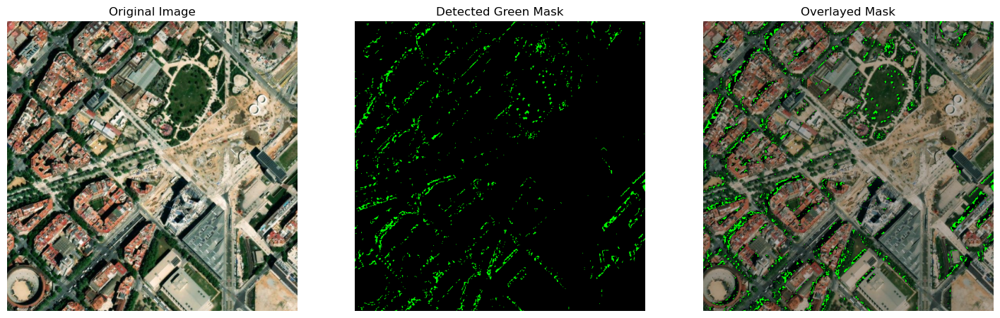

Percentage of detected green area: 2.99%


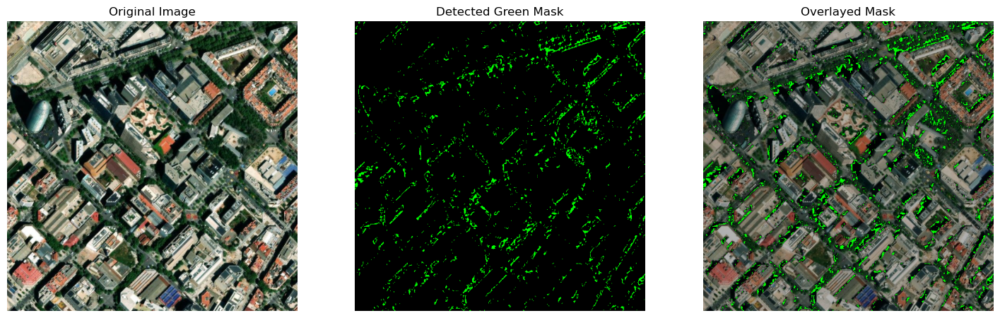

Percentage of detected green area: 4.31%


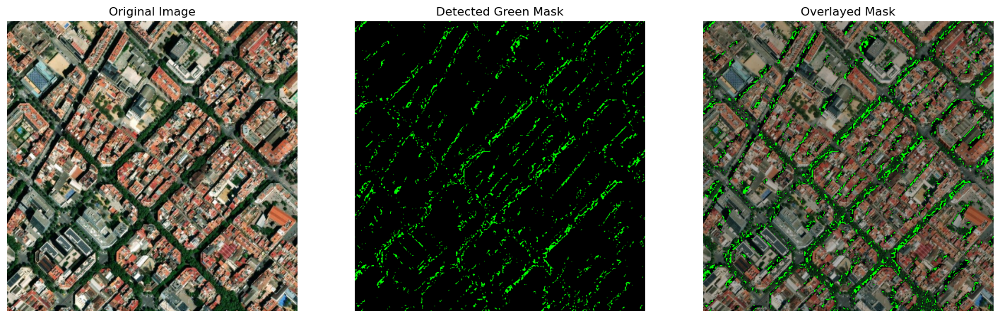

Percentage of detected green area: 4.57%


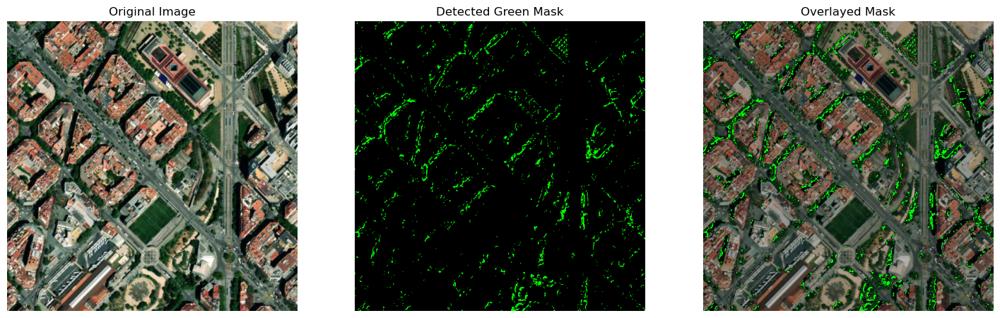

Percentage of detected green area: 3.51%


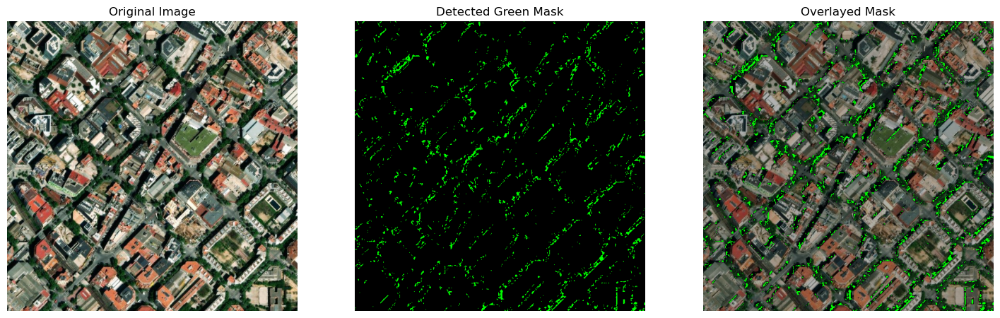

Percentage of detected green area: 3.98%


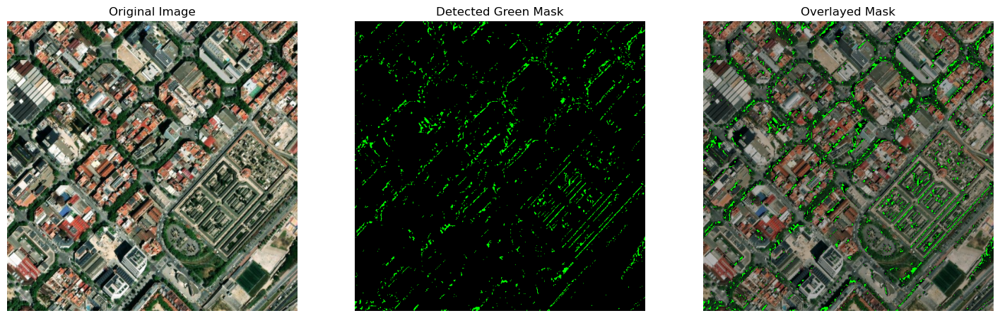

Percentage of detected green area: 3.63%


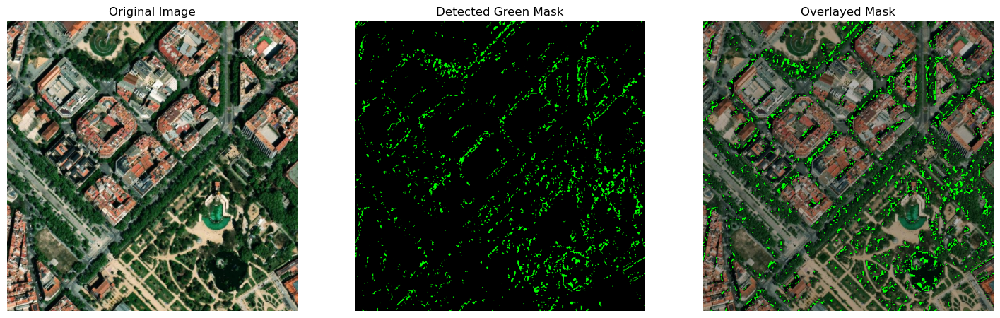

Percentage of detected green area: 4.91%


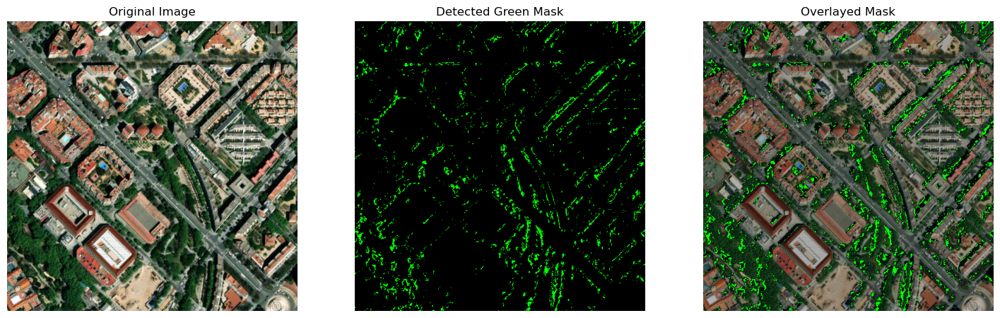

Percentage of detected green area: 4.75%


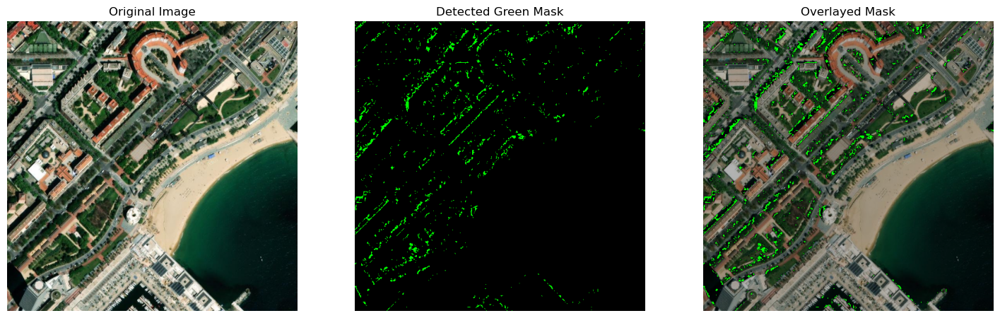

Percentage of detected green area: 2.40%


In [ ]:
import os
import cv2
import numpy as np
import matplotlib.pyplot as plt

directory_path = 'efficient_tiles/'
for filename in os.listdir(directory_path):
    if filename.endswith(".png"):
        # Get the uploaded filename
        image_path = os.path.join(directory_path, filename)

        # Load the image
        image = cv2.imread(image_path)

        # Resize the image to 500x500
        image = cv2.resize(image, (500, 500))

        # Convert BGR to RGB for correct display
        image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

        # Convert BGR to HSV for color detection
        image_hsv = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)

        # Define HSV range for Dark Green
        color_ranges = {
            "Green": ([35, 50, 30],[70, 255, 200]),  # Dark Green Range
        }

        # Create an empty mask
        final_mask = np.zeros_like(image_rgb, dtype=np.uint8)

        # Detect and overlay mask on the image
        for color_name, (lower, upper) in color_ranges.items():
            lower = np.array(lower, dtype="uint8")
            upper = np.array(upper, dtype="uint8")

            # Create a binary mask for the selected color
            mask = cv2.inRange(image_hsv, lower, upper)

            # Calculate the percentage of detected area
            total_pixels = image.shape[0] * image.shape[1]  # Total pixels in image
            detected_pixels = np.count_nonzero(mask)  # Count nonzero (detected) pixels
            detected_percentage = (detected_pixels / total_pixels) * 100  # Calculate %

            # Convert mask to 3-channel format for overlay
            mask_colored = np.zeros_like(image_rgb)
            mask_colored[:, :, 1] = mask  # Apply green channel for visualization

            # Overlay the mask on the original image
            overlaid_image = cv2.addWeighted(image_rgb, 0.7, mask_colored, 1, 0)

        # Display the original image, detected mask, and combined overlay side by side
        fig, axes = plt.subplots(1, 3, figsize=(18, 6))

        # Show Original Image
        axes[0].imshow(image_rgb)
        axes[0].set_title("Original Image")
        axes[0].axis("off")

        # Show Masked Image (Only Green Areas)
        axes[1].imshow(mask_colored)
        axes[1].set_title("Detected Green Mask")
        axes[1].axis("off")

        # Show Overlayed Image (Mask + Original)
        overlaid_image = cv2.addWeighted(image_rgb, 0.7, mask_colored, 1, 0)
        axes[2].imshow(overlaid_image)
        axes[2].set_title("Overlayed Mask")
        axes[2].axis("off")

        plt.show()
        # Print the detected area percentage
        print(f"Percentage of detected green area: {detected_percentage:.2f}%")